# Pertinence

Pour pouvoir évaluer nos recommandations, nous voulons utiliser la nDCG. Pour ce faire, nous avons besoin d'un jugement de pertinence.  
Nous allons donc créer une matrice de pertinence pour avoir le pourcentage de pertinence de chaque série par rapport à toutes les autres.  
Ex :  
Parmi tous les utilisateurs qui ont aimé la série I1, on compte ceux qui ont aussi aimé I2 et on divise par le nombre d'utilisateurs qui ont vu I1. Ça nous donne le pourcentage d'utilisateurs ayant aimé I1 qui ont aussi aimé I2.  
Plus le pourcentage est élevé, plus la recommandation est bonne.  
On considère qu'un utilisateur aime une série s'il lui a mis au moins 7.


In [37]:
import os
import re
import pandas as pd
from sklearn.decomposition import NMF
from scipy.sparse import dok_matrix
import numpy as np
import pandas as pd
from scipy.spatial.distance import sqeuclidean, cosine
import pickle

In [8]:
path_series_ratings = "/Users/constancescherer/Desktop/ratings/ratings_imdb/series"
d_series = dict() #{serie : {username: note, username : note}}

for serie in sorted(os.listdir(path_series_ratings)):
    if serie[0] == '.' :
        continue
    seriename = re.sub(".txt", "", serie)
    dico = dict()
    with open(path_series_ratings+"/"+serie) as file: 
        lignes = file.readlines()
    for ligne in lignes :
        l = ligne.split(" ")
        username = l[0]
        rating = l[-1]
        #username, rating = ligne.split(" ")
        rating = rating.rstrip("\n")
        rating = float(rating)
        dico[username] = rating
        if len(dico) > 1 :
            d_series[seriename] = dico


In [25]:
def intersection(lst1, lst2): 
    lst3 = [value for value in lst1 if value in lst2] 
    return lst3 

In [17]:
user_got = [k for k, v in d_series['game-of-thrones'].items() if v > 7]

In [18]:
user_bb = [k for k, v in d_series['breaking-bad'].items() if v > 7]

In [28]:
l = intersection(user_bb, user_got)

In [29]:
len(l)

27

In [34]:
d_pert = dict()
for serie1 in d_series.keys() :
    users1 = [k for k, v in d_series[serie1].items() if v > 7]
    d_pert[serie1] = dict()
    for serie2 in d_series.keys() :
        users2 = [k for k, v in d_series[serie2].items() if v > 7]
        inter = intersection(users1, users2)
        if len(users1) == 0 :
            d_pert[serie1][serie2] = 0
        else :
            d_pert[serie1][serie2] = len(inter)/len(users1)

In [35]:
d_pert

{'10-things-i-hate-about-you': {'10-things-i-hate-about-you': 1.0,
  '100-code': 0.0,
  '100-questions': 0.0,
  '1000-ways-to-die': 0.0,
  '1066-the-battle-for-middle-earth': 0.0,
  '12-monkeys': 0.0,
  '15-storeys-high': 0.0,
  '1600-penn': 0.0,
  '18-to-life': 0.0,
  '1864': 0.0,
  '19-2': 0.0,
  '1992': 0.0,
  '2-broke-girls': 0.0,
  '21-jump-street': 0.0,
  '24-hours-in-police-custody': 0.0,
  '3-lbs': 0.0,
  '30-rock': 0.0,
  '37-days': 0.0,
  '3rd-rock-from-the-sun': 0.0,
  '49-days': 0.0,
  '500-questions': 0.0,
  '55-degrees-north': 0.0,
  '5ive-days-to-midnight': 0.0,
  '666-park-avenue': 0.0,
  '7th-heaven': 0.0,
  '8-out-of-10-cats-does-countdown': 0.0,
  '8-out-of-10-cats': 0.0,
  '800-words': 0.0,
  '90210': 0.0,
  'a-bit-of-fry-and-laurie': 0.0,
  'a-gifted-man': 0.0,
  'a-history-of-britain': 0.0,
  'a-history-of-christianity': 0.0,
  'a-history-of-scotland': 0.0,
  'a-nero-wolfe-mystery': 0.0,
  'a-passionate-woman': 0.0,
  'a-place-to-call-home': 0.0,
  'a-to-z': 0.0,


In [38]:
pickle.dump(d_pert, open('d_pert.p', 'wb'))

In [46]:
pertinence = np.ones((len(d_series), len(d_series)))
i = 0
for serie1, dic in d_pert.items():
    j = 0
    for serie2, p in dic.items() :
        pertinence[i][j] = p
        j += 1
    i += 1

In [48]:
import matplotlib.pyplot as plt

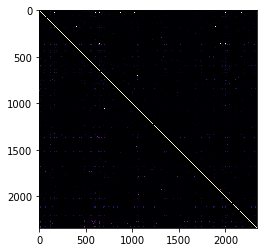

In [71]:
plt.imshow(pertinence, cmap='magma')
plt.savefig('pertinence.pdf')

Diagonale de 1 (serie1 avec serie1), quelques trous pour les séries que personne n'a noté au dessus de 7.  
Beaaaaaaaaaaaaaaaaucoup de 0, mais quelques valeurs au dessus.

In [78]:
d_max = dict()
for serie1, dic in d_pert.items() :
    maxi = -1
    for serie2, p in dic.items() :
        if p > maxi and serie1 != serie2:
            maxi = p
            d_max[serie1] = serie2

In [79]:
d_max

{'10-things-i-hate-about-you': 'alice',
 '100-code': 'the-following',
 '100-questions': 'ant-farm',
 '1000-ways-to-die': 'less-than-kind',
 '1066-the-battle-for-middle-earth': 'i-claudius',
 '12-monkeys': 'sense8',
 '15-storeys-high': 'spaced',
 '1600-penn': '10-things-i-hate-about-you',
 '18-to-life': '10-things-i-hate-about-you',
 '1864': 'alias',
 '19-2': 'longmire',
 '1992': '10-things-i-hate-about-you',
 '2-broke-girls': 'the-big-bang-theory',
 '21-jump-street': 'all-in-the-family',
 '24-hours-in-police-custody': '10-things-i-hate-about-you',
 '3-lbs': '10-things-i-hate-about-you',
 '30-rock': 'seinfeld',
 '37-days': 'game-of-thrones',
 '3rd-rock-from-the-sun': 'married-with-children',
 '49-days': 'city-hunter',
 '500-questions': '10-things-i-hate-about-you',
 '55-degrees-north': '10-things-i-hate-about-you',
 '5ive-days-to-midnight': 'gilmore-girls',
 '666-park-avenue': 'american-crime',
 '7th-heaven': 'gilmore-girls',
 '8-out-of-10-cats-does-countdown': '8-out-of-10-cats',
 '8-o

In [80]:
d_max['game-of-thrones']

'the-walking-dead'

In [153]:
d_max['stargate-sg-1']

'atlantis'

Après avoir été testé sur 2 volontaires sur quelques dizaines de séries, ce jugement de pertinence semble plutôt bon.